In [1033]:
import sys
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import sklearn.feature_selection as fs #not used
import sklearn.preprocessing as pp
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D

#load csv file
data = pd.read_csv('credit_cards.csv')

In [1034]:
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,17270,130000,2,2,1,34,0,0,0,0,...,105478,107725,109994,3700,5300,4000,4000,4000,6100,0
1,22364,290000,2,1,2,27,-1,-1,0,0,...,1503,834,931,569,1000,1000,200,265,500,0
2,23880,360000,1,1,2,27,-2,-2,-2,-2,...,1390,-5,-5,898,5970,1396,0,0,0,0
3,9074,110000,2,1,2,35,-1,2,-1,0,...,790,806,1729,0,1166,0,446,1729,0,0
4,25083,260000,1,3,1,48,0,0,0,0,...,155059,141570,134143,8000,6000,7100,5300,5000,5000,0


In [1035]:
#Create and add Remaining Amount = Bill Amt - Pay Amt
for i in range(1, 7):
    data['REM_AMT'+str(i)] = data['BILL_AMT'+str(i)] - data['PAY_AMT'+str(i)]

In [1036]:
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT,REM_AMT1,REM_AMT2,REM_AMT3,REM_AMT4,REM_AMT5,REM_AMT6
0,17270,130000,2,2,1,34,0,0,0,0,...,4000,4000,6100,0,96191,95732,100705,101478,103725,103894
1,22364,290000,2,1,2,27,-1,-1,0,0,...,200,265,500,0,-401,-431,401,1303,569,431
2,23880,360000,1,1,2,27,-2,-2,-2,-2,...,0,0,0,0,1909,-5076,4543,1390,-5,-5
3,9074,110000,2,1,2,35,-1,2,-1,0,...,446,1729,0,0,549,-987,1166,344,-923,1729
4,25083,260000,1,3,1,48,0,0,0,0,...,5300,5000,5000,0,146927,152848,153554,149759,136570,129143


In [1037]:
#make a dataset consisting only of the 18 categories we will be using BILL_AMT, PAY_AMT, and REM_AMT
categories = []
for i in range(1, 7):
    categories.append('BILL_AMT'+str(i))
    categories.append('PAY_AMT'+str(i))
    categories.append('REM_AMT'+str(i))
dataset = pd.DataFrame(data, columns=categories)

In [1038]:
#Data Preprocessing: Normalization
scaler = pp.MinMaxScaler()
dataset = pd.DataFrame(scaler.fit_transform(dataset), columns=categories)
dataset.head()

,BILL_AMT1,PAY_AMT1,REM_AMT1,BILL_AMT2,PAY_AMT2,REM_AMT2,BILL_AMT3,PAY_AMT3,REM_AMT3,BILL_AMT4,PAY_AMT4,REM_AMT4,BILL_AMT5,PAY_AMT5,REM_AMT5,BILL_AMT6,PAY_AMT6,REM_AMT6
0,0.227662,0.004236,0.503763,0.162103,0.003147,0.682239,0.143832,0.004464,0.398576,0.259497,0.006441,0.509403,0.187465,0.009378,0.401149,0.345507,0.011538,0.494135
1,0.138583,0.000651,0.445133,0.066760,0.000594,0.645752,0.087114,0.001116,0.356728,0.161554,0.000322,0.443000,0.081475,0.000621,0.321280,0.261694,0.000946,0.429321
2,0.140940,0.001028,0.446535,0.067069,0.003545,0.643990,0.089605,0.001558,0.358456,0.161447,0.000000,0.443057,0.080643,0.000000,0.320835,0.260975,0.000000,0.429048
3,0.138923,0.000000,0.445709,0.066390,0.000692,0.645541,0.086985,0.000000,0.357048,0.160882,0.000718,0.442364,0.081447,0.004054,0.320124,0.262307,0.000000,0.430134
4,0.276824,0.009158,0.534559,0.216972,0.003562,0.703911,0.174550,0.007924,0.420625,0.306201,0.008535,0.541407,0.221024,0.011723,0.426580,0.364065,0.009458,0.509952


In [1039]:
#Data Preprocessing: Peform PCA to reduce dimensionality to 3
pca = PCA(n_components=3)
reddata = pd.DataFrame(pca.fit_transform(dataset))
reddata.head()

,0,1,2
0,0.152821,0.031406,-0.007193
1,-0.109609,0.004081,-0.008823
2,-0.108326,0.002254,-0.009546
3,-0.109810,0.003727,-0.006258
4,0.268528,0.017997,-0.014390


In [1040]:
#Kmeans Implementation: rand_center
def rand_center(data,k):
    indecies = np.random.choice(len(data)-1, k)
    centroids =[]
    for i in indecies:
        centroids.append(data.loc[[i]])
    return centroids

In [1041]:
#Kmeans Implementation: converged
def converged(centroids1,centroids2):
    #check whether centroids1==centroids2
    ret = True
    for center1 in centroids1:
        same = False
        for center2 in centroids2:
            if center1.sort()== center2.sort():
                same = True
        if not same:
            ret = False
    #add proper code to handle infinite loop if it never converges
    if not ret:
        dist = np.linalg.norm(np.array(centroids1) - np.array(centroids2))
        if (dist < .001):
            return True
    return ret

In [1042]:
#Kmeans Implementation: update_centroids
def update_centroids(data,centroids,k):
    #Assign each data point to its nearest centroid based on the Euclidean distance
    label = [-1] * len(data)
    for i in range(len(data)):
        min_dist = float('inf')
        for j in range(len(centroids)):
            dist = np.linalg.norm(np.array(centroids[j]) - np.array(data.loc[[i]]))
            if (dist < min_dist):
                min_dist = dist
                label[i] = j

    #Update the cluster centroid to the mean of all the points assigned to that cluster
    clustered = data.copy()
    clustered['LABEL'] = label
    for m in range(len(centroids)):
        cluster = clustered[clustered['LABEL'] == m]
        if len(cluster) == 0:
            centroids[m] = centroids[m]
        else:
            centroids[m] = cluster.drop(labels='LABEL', axis=1).mean()
    return centroids, label

In [1043]:
#Kmeans Implementation: kmeans
def kmeans(data,k=5):
    #step 1:
    centroids = rand_center(data, k)
    converge = False
    while not converge:
        old_centroids = np.copy(centroids)
        #step 2 & 3: labels can be an array of labels for all the data points
        centroids, label = update_centroids(data, old_centroids, k)
        #step 4:
        converge = converged(old_centroids, centroids)
    print(">> final centroids")
    print(centroids)
    return centroids, label

In [1044]:
#Kmeans Evaluation: SSE
def SSE(centroids, data, label):
    error = 0
    #data = data.drop(labels='LABEL', axis=1)
    for i in range(len(data)):
        dist = np.linalg.norm(np.array(centroids[label[i]]) - np.array(data.loc[[i]]))
        error += dist**2
    return error

In [1045]:
#run Kmeans algorithm on dataset 20 times and choose the cluster with the smallest SSE
lowest_error = float('inf')
best_cluster = []
best_centroids = []
for i in range(20):
    #d = pd.DataFrame(reddata)
    centroids, label = kmeans(reddata)
    error = SSE(centroids, reddata, label)
    print("Run {0} Cluster's SSE: {1}".format(i+1, error))
    if (error < lowest_error):
        lowest_error = error
        best_cluster = label
        best_centroids = centroids
print("\n\nBest centroids: {0} \nError: {1}".format(best_centroids, lowest_error))

KeyboardInterrupt: 

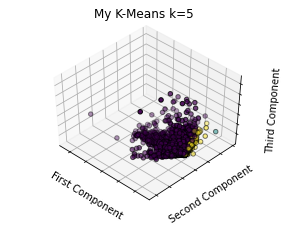

In [1004]:
#Plot My Kmeans
fig = plt.figure(2, figsize=(4, 3))
ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=48, azim=134)
labels = best_cluster

ax.scatter(reddata[0], reddata[1], reddata[2],c=labels, edgecolor='k')

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('First Component')
ax.set_ylabel('Second Component')
ax.set_zlabel('Third Component')
ax.set_title('My K-Means k=5')
ax.dist = 12
fignum = 2

fig.show()

In [1029]:
label_arr = np.array(labels)
for i in range(5):
    print((label_arr == i).sum())

16281
1
7718
0
0


In [1005]:
#Run SKlearn Kmeans 
sk_kmeans = KMeans(n_clusters=5).fit(reddata)

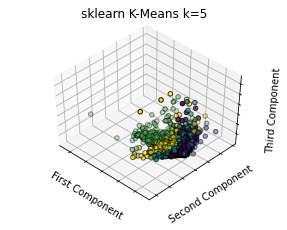

In [1006]:
#Plot SKlearn Kmeans
fig = plt.figure(1, figsize=(4, 3))
ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=48, azim=134)
labels2 = sk_kmeans.labels_

ax.scatter(reddata[0], reddata[1], reddata[2],c=labels2.astype(np.float), edgecolor='k')

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('First Component')
ax.set_ylabel('Second Component')
ax.set_zlabel('Third Component')
ax.set_title('sklearn K-Means k=5')
ax.dist = 12
fignum = 1

fig.show()

In [1030]:
label2_arr = np.array(labels2)
for i in range(5):
    print((label2_arr == i).sum())

5816
13767
2812
297
1308


In [1009]:
#find Gini index of Default status
def GINI(data, labels, default, k):
    gini = [1] * k
    clustered = data.copy()
    clustered['LABEL'] = labels
    clustered['DEFAULT'] = default
    for i in range(k):
        cluster = clustered[clustered['LABEL'] == i]
        defaults = len(cluster[cluster['DEFAULT'] == 1])
        if(len(cluster) == 0):
            gini[i] = -1
        else:
            gini[i] -= ((float(defaults) / len(cluster))**2) + ((1 - float(defaults) / len(cluster))**2)
    return gini

In [1010]:
#Gini index for each cluster of my K-Means
GINI(reddata, best_cluster, data['DEFAULT'], 5)

[0.34403676530979954, 0.0, 0.3537602805179547, -1, -1]

In [1011]:
#Gini index for each cluster of sklearn K-Means
GINI(reddata, labels2, data['DEFAULT'], 5)

[0.34386943526277647,
 0.3538538370508155,
 0.3223818263123497,
 0.40567289052137545,
 0.3276239373790084]

In [1014]:
#percentage of defaults in each cluster
def POD(data, labels, default, k):
    pod = [0] * k
    clustered = data.copy()
    clustered['LABEL'] = labels
    clustered['DEFAULT'] = default
    for i in range(k):
        cluster = clustered[clustered['LABEL'] == i]
        defaults = len(cluster[cluster['DEFAULT'] == 1])
        if(len(cluster) == 0):
            pod[i] = -1
        else:
            pod[i] = (float(defaults) / len(cluster))
    return pod

In [1015]:
#Percentage of defaults for each cluster of my K-Means
POD(reddata, best_cluster, data['DEFAULT'], 5)

[0.22074811129537497, 1.0, 0.22959315884944287, -1, -1]

In [1016]:
#Percentage fo defaults for each cluster of sklearn K-Means
POD(reddata, labels2, data['DEFAULT'], 5)

[0.22059834938101788,
 0.22967966877315318,
 0.2019914651493599,
 0.2828282828282828,
 0.20642201834862386]

>> final centroids
[[ 0.00318771  0.00329044  0.0459106 ]
 [-0.09922301 -0.00711137 -0.00688936]]
>> final centroids
[[-3.69560967e-06  7.15236568e-06  1.82533933e-04]
 [-2.01146722e-01 -1.55397210e-02  3.95349446e-02]
 [-2.31726727e-01 -1.60813138e-01  6.74505119e-02]]
>> final centroids
[[ 0.01428439  0.01877275  0.29227977]
 [-0.05212615 -0.00329363 -0.00256602]
 [-0.39876185 -0.24373424  0.1781431 ]
 [-0.18996795 -0.14008286  0.03977737]]
>> final centroids
[[-0.23408058 -0.2292034   0.07979219]
 [-0.0581422  -0.00359547 -0.00296623]
 [-0.08797946 -0.08797946 -0.08797946]
 [-0.23015749 -0.11521963  0.05922273]
 [ 0.01299894  0.01610973  0.25646814]]
>> final centroids
[[-0.51536892  0.06808536  0.22861157]
 [-0.07742017 -0.00449652 -0.00432356]
 [ 0.0989199   0.10201372  0.96675532]
 [ 0.03243584  0.04286395  0.61217136]
 [ 0.00601427  0.00711786  0.1233123 ]
 [-0.23172673 -0.16081314  0.06745051]]
>> final centroids
[[-0.07000196 -0.00371626 -0.00351368]
 [ 0.00110943  0.00551157 

<function matplotlib.pyplot.show(*args, **kw)>

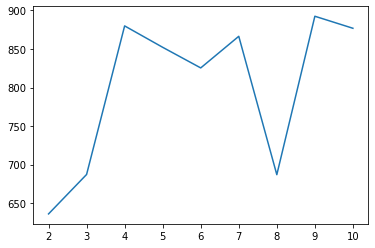

In [1047]:
#test my K-means with k values 2-10
lowest_error = float('inf')
best_k_labels = []
best_k_centroids = []
k_SSE = [0] * 11

for k in range(2,11):
    centroids, label = kmeans(reddata, k=k)
    k_SSE[k] = SSE(centroids, reddata, label)
    if (k_SSE[k] < lowest_error):
        lowest_error = k_SSE[k]
        best_k_labels = label
        best_k_centroids = centroids

plt.plot([2,3,4,5,6,7,8,9,10], k_SSE[2:11])
plt.show

In [1048]:
#Gini index for each cluster of my K-Means k=10
GINI(reddata, best_k_labels, data['DEFAULT'], 10)

[0.34342108242497926, 0.35531314644331946, -1, -1, -1, -1, -1, -1, -1, -1]

In [1049]:
#Percentage of defaults for each cluster of my K-Means k=10
POD(reddata, best_k_labels, data['DEFAULT'], 10)

[0.22019746465138956, 0.23103266596417282, -1, -1, -1, -1, -1, -1, -1, -1]

In [1051]:
labelk10_arr = np.array(best_k_labels)
for i in range(10):
    print((labelk10_arr == i).sum())

16408
7592
0
0
0
0
0
0
0
0


<function matplotlib.pyplot.show(*args, **kw)>

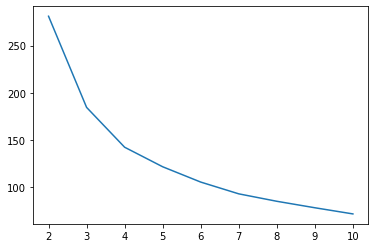

In [1050]:
#test sklearn K-means with k values 2-10
sk_lowest_error = float('inf')
sk_best_k_labels = []
sk_best_k_centroids = []
sk_k_SSE = [0] * 11

for k in range(2,11):
    sk_k_kmean = KMeans(n_clusters=k).fit(reddata)
    sk_k_SSE[k] = SSE(sk_k_kmean.cluster_centers_, reddata, sk_k_kmean.labels_)
    if (sk_k_SSE[k] < lowest_error):
        sk_lowest_error = sk_k_SSE[k]
        sk_best_k_cluster = label
        sk_best_k_centroids = centroids

plt.plot([2,3,4,5,6,7,8,9,10], sk_k_SSE[2:11])
plt.show

In [1052]:
#Gini index for each cluster of sklearn K-Means k=10
GINI(reddata, sk_best_k_cluster, data['DEFAULT'], 10)

[0.4444444444444444,
 0.0,
 0.0,
 0.3363743512110726,
 0.28829200555445356,
 0.3385720380484245,
 0.32281490016164405,
 0.3422781009570275,
 0.3266199109686797,
 0.35835866638076763]

In [1054]:
#Percentage fo defaults for each cluster of sklearn K-Means k=10
POD(reddata, sk_best_k_cluster, data['DEFAULT'], 10)

[0.3333333333333333,
 1.0,
 1.0,
 0.2139705882352941,
 0.17464788732394365,
 0.21589793915603533,
 0.2023549934583515,
 0.2191780821917808,
 0.2055682684973303,
 0.23387847360723307]

In [1056]:
label2k10_arr = np.array(sk_best_k_cluster)
for i in range(10):
    print((label2k10_arr == i).sum())

3
1
1
1360
710
1019
2293
949
2622
15042


In [1019]:
#run kmeans without normalizing
for i in range(1, 7):
    categories.append('BILL_AMT'+str(i))
    categories.append('PAY_AMT'+str(i))
    categories.append('REM_AMT'+str(i))
dataset2 = pd.DataFrame(data, columns=categories)
dataset2.head()

,BILL_AMT1,PAY_AMT1,REM_AMT1,BILL_AMT2,PAY_AMT2,REM_AMT2,BILL_AMT3,PAY_AMT3,REM_AMT3,BILL_AMT4,...,REM_AMT3,BILL_AMT4,PAY_AMT4,REM_AMT4,BILL_AMT5,PAY_AMT5,REM_AMT5,BILL_AMT6,PAY_AMT6,REM_AMT6
0,99891,3700,96191,101032,5300,95732,104705,4000,100705,105478,...,100705,105478,4000,101478,107725,4000,103725,109994,6100,103894
1,168,569,-401,569,1000,-431,1401,1000,401,1503,...,401,1503,200,1303,834,265,569,931,500,431
2,2807,898,1909,894,5970,-5076,5939,1396,4543,1390,...,4543,1390,0,1390,-5,0,-5,-5,0,-5
3,549,0,549,179,1166,-987,1166,0,1166,790,...,1166,790,446,344,806,1729,-923,1729,0,1729
4,154927,8000,146927,158848,6000,152848,160654,7100,153554,155059,...,153554,155059,5300,149759,141570,5000,136570,134143,5000,129143


In [1020]:
#Data Preprocessing: Peform PCA to reduce dimensionality to 3
pca = PCA(n_components=3)
reddata2 = pd.DataFrame(pca.fit_transform(dataset2))
reddata2.head()

,0,1,2
0,290383.530479,58548.604872,-17177.417275
1,-205742.297398,2243.873331,-1345.306206
2,-202554.798852,1881.155047,10200.728619
3,-205829.771300,1853.584339,-1244.881715
4,516550.845323,30852.314013,-1434.698435


In [1021]:
#run Kmeans algorithm on dataset2 (not normalized) 20 times and choose the cluster with the smallest SSE
lowest_error2 = float('inf')
best_cluster2 = []
best_centroids2 = []
for i in range(20):
    centroids, label = kmeans(reddata2)
    error = SSE(centroids, reddata2, label)
    print("Run {0} Cluster's SSE: {1}".format(i+1, error))
    if (error < lowest_error2):
        lowest_error2 = error
        best_cluster2 = label
        best_centroids2 = centroids
print("\n\nBest centroids: {0} \nError: {1}".format(best_centroids2, lowest_error2))

>> final centroids
[[-5.56353527e+05 -5.42743704e+05  4.39632484e+05]
 [-9.38677838e+05 -3.68540036e+05  6.88059101e+05]
 [-1.60742790e+01  1.56689512e+01  1.43764907e+02]
 [-3.74409926e+05 -1.00506907e+05 -4.35563751e+04]
 [-8.44843862e+05 -1.45532541e+05  3.84649801e+05]]
Run 1 Cluster's SSE: 2439670168752043.5
>> final centroids
[[-7.40710771e+05  3.55462236e+04  6.58527872e+04]
 [-3.09103018e+05 -8.86817242e+04  4.35324424e+04]
 [ 9.36977226e+05  1.17569652e+06  2.00789800e+06]
 [-2.35467014e+02 -7.86481855e+01  5.79694059e+02]
 [-4.96352480e+05 -6.60195143e+04 -1.12794484e+04]]
Run 2 Cluster's SSE: 2423502046362712.5
>> final centroids
[[ -40454.10039635   -2573.52493143   -1382.92400272]
 [-844843.86162153 -145532.54130407  384649.80140915]
 [  35696.7497847    68868.10626486 1041218.91168327]
 [-740710.77100309   35546.22361162   65852.78720059]
 [-231175.99515729 -231175.99515729 -231175.99515729]]
Run 3 Cluster's SSE: 3237161890053987.0
>> final centroids
[[   4148.92464237   

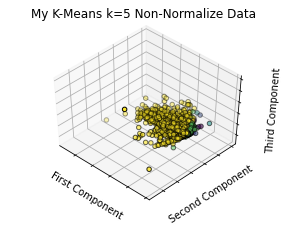

In [1023]:
#Plot My Kmeans with non-normalized data
fig = plt.figure(3, figsize=(4, 3))
ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=48, azim=134)

ax.scatter(reddata2[0], reddata2[1], reddata2[2],c=best_cluster2, edgecolor='k')

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('First Component')
ax.set_ylabel('Second Component')
ax.set_zlabel('Third Component')
ax.set_title('My K-Means k=5 Non-Normalize Data')
ax.dist = 12
fignum = 3

fig.show()

In [1024]:
#Run SKlearn Kmeans 
sk_kmeans2 = KMeans(n_clusters=5).fit(reddata2)

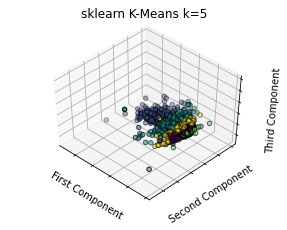

In [1025]:
#Plot SKlearn Kmeans
fig = plt.figure(4, figsize=(4, 3))
ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=48, azim=134)
labels_sk2 = sk_kmeans2.labels_

ax.scatter(reddata2[0], reddata2[1], reddata2[2],c=labels_sk2.astype(np.float), edgecolor='k')

ax.w_xaxis.set_ticklabels([])
ax.w_yaxis.set_ticklabels([])
ax.w_zaxis.set_ticklabels([])
ax.set_xlabel('First Component')
ax.set_ylabel('Second Component')
ax.set_zlabel('Third Component')
ax.set_title('sklearn K-Means k=5 Non Normalized data')
ax.dist = 12
fignum = 4

fig.show()